## Setup

In [2]:
# this notebook is designed to run in conda environment 'wasp'
%run -i 'surfacedef2los.py'

# Pick which model you are using 
model = 'melgar_2023'
# Pick which scene and track you are using 
scene = 's1_20230129-20230210_p21'
# Set the path to all of the geotiffs processed with ISCE
tiffdir = '/Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/observation-files/usgs-isce-geotiffs/'

## Set the corresponding field names
if model=='usgs_planar':
    disp_file = 'surface-displacement-files/surface_deformation_usgs_cutde_150_100.disp'
    print('Using the', model, 'model')
elif model=='melgar_2023':
    disp_file = '/Users/hyin/yin_usgs/turkiye_2023/surfacedef2LOS/surface-displacement-files/surface_deformation_melgar_combined_triangles.disp'
    print('Using the', model, 'model')
else:
    print('No matching model found')


Using the melgar_2023 model


## Read in Geotiff Files

In [3]:
# Read in the observed data Range offset data
geotiff_file = tiffdir + scene + '_range.tif'
# Read it in as an xarray dataset
range_offsets_ds = geotiff2xarray(geotiff_file)
# rename data variable to something unique
range_offsets_ds = range_offsets_ds.rename({'los_obs':'rng_offset'})

# Read in the observed Azimuth offset data
geotiff_file = tiffdir + scene + '_azimuth.tif'
# Read it in as an xarray dataset
azimuth_offsets_ds = geotiff2xarray(geotiff_file)
# rename data variable to something unique
azimuth_offsets_ds = azimuth_offsets_ds.rename({'los_obs':'az_offset'})

# Red in the Look vectors geotiff
geotiff_file = tiffdir + scene + '_los.tif'
# Calculate the look vectors at each point and write to a dataset
look_ds = geotiff2look(geotiff_file)

# Merge all observations (Range offsets, Azimuth offsets, and Look vectors) into a single dataset
observed_look_ds = xr.combine_by_coords([look_ds,azimuth_offsets_ds, range_offsets_ds], join='outer')

Mean incidence angle (deg):  38.891403
Mean azimuth angle (deg):  -100.085594
Mean LOS look vector (e, n, u): (  0.6162829 , -0.10917199 , 0.7759419 )
**Note: Positive values indicate motion in the direction of the satellite
This is the same as the range offset look vector
Mean Azimuth offset look vector (e, n, u): (  -0.1751383 , -0.9843732 , 0.0 )
**Note: Positive values indicate motion in the along-track direction of the satellite (i.e. the direction that the satellite is moving is positive)


## Get Modeled Data

In [4]:
# Read in Synthetic data
df = pd.read_csv(disp_file, sep='\t',header=0, names=['lon','lat', 'elev','disp_e','disp_n','disp_u'])
df = df.set_index(['lat', 'lon']) # set lat and lon to coordinates
modeled_disp = df.to_xarray() # convert it to an xarray dataset

# Interpolate the modeled data to match the sampling of observed data
interp_synth = modeled_disp.interp_like(observed_look_ds)

# Merge to MEGADATA
mega_ds = xr.combine_by_coords([interp_synth,observed_look_ds], join='outer')

## Project the modeled data into Azimuth Look vector

In [5]:
# Project displacements into Azimuth Offset Look Vector
az_mod_proj = mega_ds.az_e * mega_ds.disp_e + mega_ds.az_n * mega_ds.disp_n + mega_ds.az_u * mega_ds.disp_u
# Calculate residuals 
az_mod_proj_residual = mega_ds.az_offset - az_mod_proj

## Project the modeled data into Range Look vector

In [6]:
# Project displacements into Range Look Vector 
rng_mod_proj = (-mega_ds.los_e) * mega_ds.disp_e + (-mega_ds.los_n) * mega_ds.disp_n + mega_ds.los_u * mega_ds.disp_u
# Get the range residual
rng_mod_proj_residual = mega_ds.rng_offset - rng_mod_proj

## Plot the Residuals

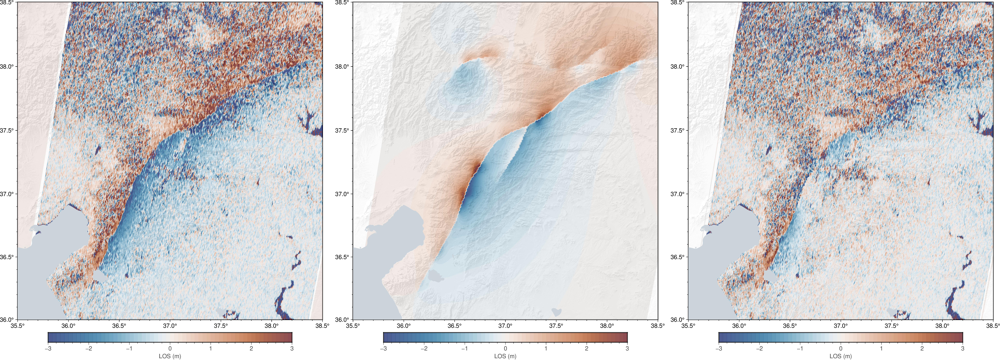

In [7]:
# Azimuth Residuals
obs_da = mega_ds.az_offset
model_da = az_mod_proj
residual_da = az_mod_proj_residual

fig = residual_plot(obs_da, model_da, residual_da)
fig.show()
fig.savefig('plots/A014_azimuth_offset_residuals.jpg')

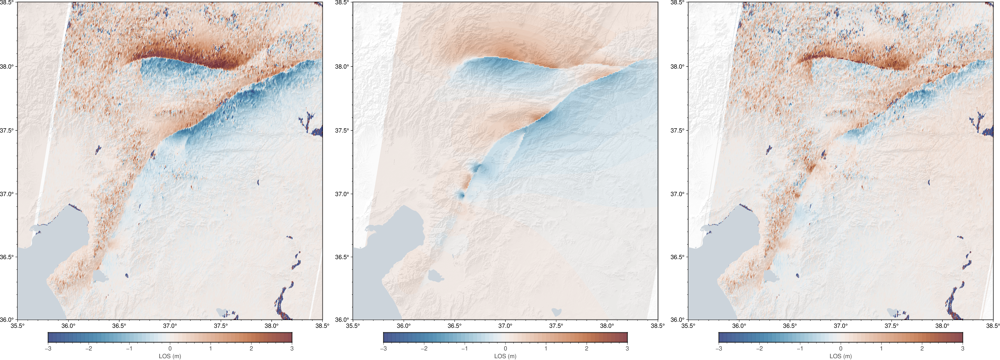

In [8]:
# Range Residuals

obs_da = mega_ds.rng_offset
model_da = rng_mod_proj
residual_da = rng_mod_proj_residual

fig = residual_plot(obs_da, model_da, residual_da)
fig.show()
fig.savefig('plots/A014_range_offset_residuals.jpg')